# Reading data with [pandas](https://pandas.pydata.org/)

[pandas](https://pandas.pydata.org/) has a very versatile csv reader that can easily import data from different file formats. This is useful for any climate time series, but also earthquake data. Here, we will use a few core tools from pandas to read and plot data. pandas is a very powerful library with many statistical options - and it is often the tool of choice for data scientists to work with tabular data or time series. It is not useful for array (2D) data, but if you have individual time series and data attributes, it will be a your tool of choice.

pandas allows seamless integration with xarray and numpy arrays. 

We will not be able to cover all details of pandas, and here are some additional resources that may come in handy:
- https://pandas.pydata.org/docs/user_guide/10min.html
- https://pandas.pydata.org/docs/getting_started/tutorials.html
- https://github.com/KeithGalli/complete-pandas-tutorial

This is actually one of the view software packages for which I achquired the book by the author/programmer (Wes McKinney)
https://wesmckinney.com/book/
If you are planing to use pandas during the PhD research, you may want to look into obtaining an ePDF.


In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os

# First Steps
## Load data into pandas

See for header or column explanation: https://earthquake.usgs.gov/data/comcat/#event-terms

nst - The total number of seismic stations used to determine earthquake location.

In [3]:
# dirname='/home/bodo/Dropbox/Teaching/Python_WS_May2025/EQ_data'
dirname='../EQ_data'
fname=os.path.join(dirname, 'USGS_Mag5_1990_1994.csv')
EQ5 = pd.read_csv(fname)
EQ5.head()

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
0,1994-12-31T20:52:27.750Z,35.820,139.993,75.8,5.1,mw,NaN,NaN,NaN,0.9,...,2016-11-10T00:20:19.469Z,"4 km SSE of Kashiwa, Japan",earthquake,NaN,3.8,NaN,NaN,reviewed,us,hrv
1,1994-12-31T20:10:26.030Z,20.783,146.652,33.0,5.3,mb,NaN,NaN,NaN,0.9,...,2014-11-07T00:57:00.984Z,Mariana Islands region,earthquake,NaN,NaN,NaN,12.0,reviewed,us,us
2,1994-12-31T17:17:26.810Z,40.183,142.786,33.0,5.0,mb,NaN,NaN,NaN,1.0,...,2014-11-07T00:57:00.965Z,"93 km NE of Miyako, Japan",earthquake,NaN,NaN,NaN,19.0,reviewed,us,us
3,1994-12-31T13:50:23.700Z,40.217,142.546,43.0,6.0,mw,NaN,NaN,NaN,1.0,...,2022-04-28T17:19:41.067Z,"81 km NE of Miyako, Japan",earthquake,NaN,4.0,NaN,NaN,reviewed,us,hrv
4,1994-12-31T11:05:59.870Z,2.475,126.188,86.8,5.2,mb,NaN,NaN,NaN,0.7,...,2014-11-07T00:57:00.923Z,"173 km NE of Laikit, Laikit II (Dimembe), Indo...",earthquake,NaN,8.6,NaN,16.0,reviewed,us,us


In [4]:
len(EQ5)

8281

In [5]:
EQ5.dtypes

time                object
latitude           float64
longitude          float64
depth              float64
mag                float64
magType             object
nst                float64
gap                float64
dmin               float64
rms                float64
net                 object
id                  object
updated             object
place               object
type                object
horizontalError    float64
depthError         float64
magError           float64
magNst             float64
status              object
locationSource      object
magSource           object
dtype: object

In [6]:
# re-read file and properly import dates and use USGS ID as id
EQ5 = pd.read_csv(fname, 
                  parse_dates=['time', 'updated'], 
                  index_col='id') #date cols specified and index col specified)
EQ5.head()

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
id,,,,,,,,,,,,,,,,,,,,,
usp0006qpb,1994-12-31 20:52:27.750000+00:00,35.820,139.993,75.8,5.1,mw,NaN,NaN,NaN,0.9,...,2016-11-10 00:20:19.469000+00:00,"4 km SSE of Kashiwa, Japan",earthquake,NaN,3.8,NaN,NaN,reviewed,us,hrv
usp0006qp8,1994-12-31 20:10:26.030000+00:00,20.783,146.652,33.0,5.3,mb,NaN,NaN,NaN,0.9,...,2014-11-07 00:57:00.984000+00:00,Mariana Islands region,earthquake,NaN,NaN,NaN,12.0,reviewed,us,us
usp0006qp1,1994-12-31 17:17:26.810000+00:00,40.183,142.786,33.0,5.0,mb,NaN,NaN,NaN,1.0,...,2014-11-07 00:57:00.965000+00:00,"93 km NE of Miyako, Japan",earthquake,NaN,NaN,NaN,19.0,reviewed,us,us
usp0006qny,1994-12-31 13:50:23.700000+00:00,40.217,142.546,43.0,6.0,mw,NaN,NaN,NaN,1.0,...,2022-04-28 17:19:41.067000+00:00,"81 km NE of Miyako, Japan",earthquake,NaN,4.0,NaN,NaN,reviewed,us,hrv
usp0006qnv,1994-12-31 11:05:59.870000+00:00,2.475,126.188,86.8,5.2,mb,NaN,NaN,NaN,0.7,...,2014-11-07 00:57:00.923000+00:00,"173 km NE of Laikit, Laikit II (Dimembe), Indo...",earthquake,NaN,8.6,NaN,16.0,reviewed,us,us


In [7]:
EQ5.dtypes

time               datetime64[ns, UTC]
latitude                       float64
longitude                      float64
depth                          float64
mag                            float64
magType                         object
nst                            float64
gap                            float64
dmin                           float64
rms                            float64
net                             object
updated            datetime64[ns, UTC]
place                           object
type                            object
horizontalError                float64
depthError                     float64
magError                       float64
magNst                         float64
status                          object
locationSource                  object
magSource                       object
dtype: object

In [8]:
EQ5.tail()

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
id,,,,,,,,,,,,,,,,,,,,,
usp00043tv,1990-01-01 18:03:19.250000+00:00,6.830,-72.995,157.8,5.3,mb,NaN,NaN,NaN,1.1,...,2014-11-07 00:45:27.077000+00:00,"8 km NNW of Cepitá, Colombia",earthquake,NaN,5.8,NaN,24.0,reviewed,us,us
usp00043tu,1990-01-01 17:21:38.880000+00:00,-19.151,167.313,10.0,5.3,mw,NaN,NaN,NaN,1.1,...,2016-11-09 21:34:43.923000+00:00,"185 km NNE of Fayaoué, New Caledonia",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
usp00043tq,1990-01-01 16:07:27.320000+00:00,-7.183,125.242,527.1,5.3,mw,NaN,NaN,NaN,1.1,...,2016-11-09 21:34:43.440000+00:00,"155 km N of Likisá, Timor Leste",earthquake,NaN,4.7,NaN,NaN,reviewed,us,hrv
usp00043tp,1990-01-01 14:49:00.690000+00:00,-10.507,161.387,36.7,5.2,mw,NaN,NaN,NaN,0.9,...,2022-04-28 20:00:28.519000+00:00,"58 km W of Kirakira, Solomon Islands",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
usp00043tf,1990-01-01 07:49:35.570000+00:00,-21.772,-179.361,599.5,5.4,mw,NaN,NaN,NaN,1.1,...,2016-11-09 21:34:42.445000+00:00,Fiji region,earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv


In [9]:
EQ5.describe()

,latitude,longitude,depth,mag,nst,gap,dmin,rms,horizontalError,depthError,magError,magNst
count,8281.000000,8281.00000,8281.000000,8281.000000,59.000000,59.000000,20.000000,8248.000000,30.000000,1970.000000,8.00000,4542.000000
mean,2.543270,47.50347,79.367727,5.371458,38.745763,128.486441,0.363207,1.052934,6.371467,10.270811,0.14100,24.377807
std,28.382864,123.39219,127.093920,0.416448,65.311348,91.287019,0.427875,0.213430,19.982580,8.182647,0.12865,24.435867
min,-72.448000,-179.99700,-3.000000,5.000000,0.000000,14.300000,0.004505,-1.000000,0.071000,-1.000000,0.02000,0.000000
25%,-17.421000,-71.48300,24.100000,5.100000,0.000000,39.950000,0.106975,0.900000,0.385000,5.400000,0.03500,7.000000
50%,-3.181000,120.71700,33.000000,5.200000,3.000000,113.000000,0.198400,1.100000,0.847000,8.200000,0.10900,16.000000
75%,24.037000,143.90000,67.700000,5.500000,50.500000,198.000000,0.404900,1.200000,1.697500,12.275000,0.22250,34.000000
max,86.986000,179.99900,684.900000,8.300000,332.000000,296.000000,1.473000,1.700000,88.540000,91.295000,0.38000,328.000000


In [10]:
#rotate by 90 degree
EQ5.describe().T

,count,mean,std,min,25%,50%,75%,max
latitude,8281.0,2.543270,28.382864,-72.448000,-17.421000,-3.1810,24.0370,86.986
longitude,8281.0,47.503470,123.392190,-179.997000,-71.483000,120.7170,143.9000,179.999
depth,8281.0,79.367727,127.093920,-3.000000,24.100000,33.0000,67.7000,684.900
mag,8281.0,5.371458,0.416448,5.000000,5.100000,5.2000,5.5000,8.300
nst,59.0,38.745763,65.311348,0.000000,0.000000,3.0000,50.5000,332.000
gap,59.0,128.486441,91.287019,14.300000,39.950000,113.0000,198.0000,296.000
dmin,20.0,0.363207,0.427875,0.004505,0.106975,0.1984,0.4049,1.473
rms,8248.0,1.052934,0.213430,-1.000000,0.900000,1.1000,1.2000,1.700
horizontalError,30.0,6.371467,19.982580,0.071000,0.385000,0.8470,1.6975,88.540
depthError,1970.0,10.270811,8.182647,-1.000000,5.400000,8.2000,12.2750,91.295


In [11]:
EQ5.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8281 entries, usp0006qpb to usp00043tf
Data columns (total 21 columns):
 #   Column           Non-Null Count  Dtype              
---  ------           --------------  -----              
 0   time             8281 non-null   datetime64[ns, UTC]
 1   latitude         8281 non-null   float64            
 2   longitude        8281 non-null   float64            
 3   depth            8281 non-null   float64            
 4   mag              8281 non-null   float64            
 5   magType          8281 non-null   object             
 6   nst              59 non-null     float64            
 7   gap              59 non-null     float64            
 8   dmin             20 non-null     float64            
 9   rms              8248 non-null   float64            
 10  net              8281 non-null   object             
 11  updated          8281 non-null   datetime64[ns, UTC]
 12  place            8281 non-null   object             
 13  type    

## Very quick way to plot and visualize data (we do more advanced plotting later)

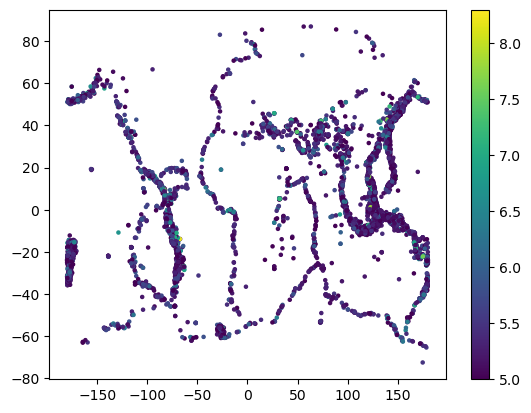

In [12]:
plt.scatter(EQ5.longitude, EQ5.latitude, c=EQ5.mag, s=5)
plt.colorbar()
#plt.axis('equal')

## Some general data analysis
### 20 largest events

In [13]:
EQ5.nlargest(20,'mag')

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
id,,,,,,,,,,,,,,,,,,,,,
usp0006kdp,1994-10-04 13:22:55.840000+00:00,43.773,147.321,14.0,8.3,mw,NaN,NaN,NaN,0.9,...,2022-04-28 17:22:14.274000+00:00,"48 km E of Shikotan, Russia",earthquake,NaN,4.7,NaN,NaN,reviewed,us,hrv
usp0006dzc,1994-06-09 00:33:16.230000+00:00,-13.841,-67.553,631.3,8.2,mw,NaN,NaN,NaN,1.1,...,2022-04-28 17:38:56.965000+00:00,"55 km NNW of Reyes, Bolivia",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
usp0006qh3,1994-12-28 12:19:23.030000+00:00,40.525,143.419,26.5,7.8,mw,NaN,NaN,NaN,1.1,...,2022-04-28 17:19:03.747000+00:00,"off the east coast of Honshu, Japan",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
usp0006djk,1994-06-02 18:17:34.020000+00:00,-10.477,112.835,18.4,7.8,mw,NaN,NaN,NaN,1.1,...,2022-05-09 22:49:51.097000+00:00,"249 km SSW of Kencong, Indonesia",earthquake,NaN,4.0,NaN,NaN,reviewed,us,hrv
usp0005y3k,1993-08-08 08:34:24.930000+00:00,12.982,144.801,59.3,7.8,mw,NaN,NaN,NaN,1.1,...,2025-05-04 03:45:17.598000+00:00,"32 km S of Inarajan Village, Guam",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
usp0005j5a,1992-12-12 05:29:26.350000+00:00,-8.480,121.896,27.7,7.8,mw,NaN,NaN,NaN,1.4,...,2022-04-28 18:25:34.047000+00:00,"37 km WNW of Maumere, Indonesia",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
usp000482z,1990-04-18 13:39:19.010000+00:00,1.186,122.857,25.7,7.8,mw,NaN,NaN,NaN,1.2,...,2022-04-28 19:52:05.247000+00:00,"75 km NNW of Gorontalo, Indonesia",earthquake,NaN,NaN,NaN,NaN,reviewed,us,par
usp0005w12,1993-07-12 13:17:11.960000+00:00,42.851,139.197,16.7,7.7,mw,NaN,NaN,NaN,1.0,...,2022-04-28 18:06:42.334000+00:00,"107 km W of Iwanai, Japan",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
usp0005ddn,1992-09-02 00:16:01.690000+00:00,11.742,-87.340,44.8,7.7,mw,NaN,NaN,NaN,1.3,...,2022-04-28 18:34:44.810000+00:00,"83 km SSW of Corinto, Nicaragua",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv


(np.float64(-197.9968),
 np.float64(197.9988),
 np.float64(-80.41969999999999),
 np.float64(94.9577))

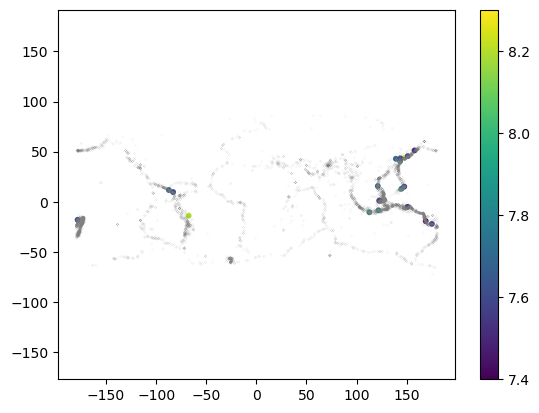

In [14]:
plt.plot(EQ5.longitude, EQ5.latitude, '.', ms=0.1, color='gray')
plt.scatter(EQ5.nlargest(20,'mag').longitude, EQ5.nlargest(20,'mag').latitude, c=EQ5.nlargest(20,'mag').mag, s=10)
plt.colorbar()
plt.axis('equal')

### Filtering a Dataset: Magnitude 5.5 or larger Earthquakes

In [15]:
EQ5['mag'] > 5.5

id
usp0006qpb    False
usp0006qp8    False
usp0006qp1    False
usp0006qny     True
usp0006qnv    False
              ...  
usp00043tv    False
usp00043tu    False
usp00043tq    False
usp00043tp    False
usp00043tf    False
Name: mag, Length: 8281, dtype: bool

In [16]:
filter = EQ5['mag'] > 5.5
EQ55 = EQ5[filter]
EQ55.head()

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
id,,,,,,,,,,,,,,,,,,,,,
usp0006qny,1994-12-31 13:50:23.700000+00:00,40.217,142.546,43.0,6.0,mw,NaN,NaN,NaN,1.0,...,2022-04-28 17:19:41.067000+00:00,"81 km NE of Miyako, Japan",earthquake,NaN,4.0,NaN,NaN,reviewed,us,hrv
usp0006qmz,1994-12-30 15:12:25.280000+00:00,18.552,145.363,219.2,6.3,mwb,NaN,NaN,NaN,1.0,...,2022-04-28 17:19:37.250000+00:00,"Pagan region, Northern Mariana Islands",earthquake,NaN,NaN,NaN,NaN,reviewed,us,us
usp0006qjq,1994-12-28 22:54:47.530000+00:00,40.187,143.583,29.6,5.8,mb,NaN,NaN,NaN,0.9,...,2022-04-28 17:19:31.311000+00:00,"152 km ENE of Miyako, Japan",earthquake,NaN,NaN,NaN,66.0,reviewed,us,us
usp0006qjm,1994-12-28 22:37:46.340000+00:00,40.375,143.636,10.5,6.4,mwb,NaN,NaN,NaN,0.8,...,2022-04-28 17:19:30.084000+00:00,"165 km ENE of Miyako, Japan",earthquake,NaN,NaN,NaN,NaN,reviewed,us,us
usp0006qjh,1994-12-28 22:23:55.890000+00:00,-32.961,179.862,54.4,5.7,mw,NaN,NaN,NaN,1.5,...,2022-04-28 17:19:28.747000+00:00,south of the Kermadec Islands,earthquake,NaN,16.3,NaN,NaN,reviewed,us,hrv


In [17]:
print(len(EQ5))
print(len(EQ55))

8281
1923


### Make a histogram of earthquake magnitude

Text(0.5, 1.0, 'Frequency of all earthquakes')

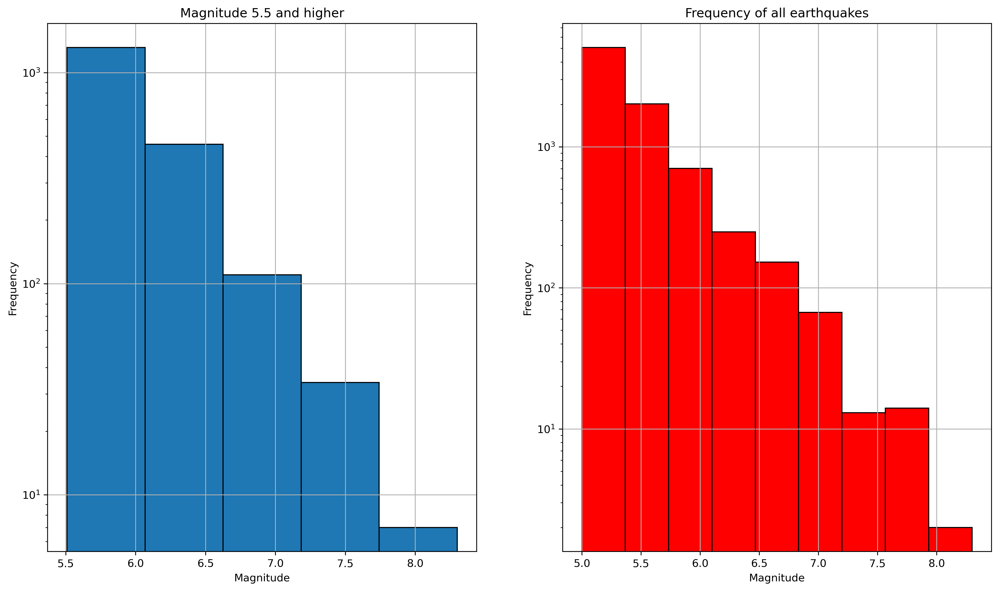

In [18]:
#create figure
plt.figure(figsize=(16,9), dpi=300)

#create subplots
plt.subplot(1,2,1) #1 row, 2 cols and first position
#histogram, with ylog scale, grid and edges of bins in black
EQ55['mag'].plot(kind='hist',logy=True, grid=True, edgecolor='black', bins=5)

plt.xlabel('Magnitude')
plt.title('Magnitude 5.5 and higher')

plt.subplot(1,2,2)
EQ5['mag'].plot(kind='hist',logy=True, grid=True, color='red', edgecolor='black', bins=9)
plt.xlabel('Magnitude')
plt.title('Frequency of all earthquakes')

### Loading more data and merge pandas dataframes

We are only working with a single earthquake file containing data from 1990-1995

In [27]:
!conda install -y -c conda-forge tqdm

Channels:
 - conda-forge
 - defaults
Platform: linux-64
Solving environment: done

# All requested packages already installed.



In [19]:
!ls ../EQ_data

significant-volcanic-eruption-database.csv  USGS_Mag5_2006-2015.csv.gz
USGS_Mag5_1990_1994.csv			    USGS_Mag5_2015-2025.csv.gz
USGS_Mag5_1995_2000.csv.gz		    USGS_Mag6_1980_2025.csv
USGS_Mag5_2000-2006.csv.gz		    volcano.csv


Pandas can directly load gz (gzip) files. Let's write a wrapper that loads all *.gz files in that directory:

In [20]:
import glob, tqdm
filelist = glob.glob('../EQ_data/*.gz')
filelist

['../EQ_data/USGS_Mag5_1995_2000.csv.gz',
 '../EQ_data/USGS_Mag5_2006-2015.csv.gz',
 '../EQ_data/USGS_Mag5_2000-2006.csv.gz',
 '../EQ_data/USGS_Mag5_2015-2025.csv.gz']

In [21]:
li=[]
for fname in tqdm.tqdm(filelist):
    df = pd.read_csv(fname, parse_dates=['time','updated'], index_col='id')
    li.append(df)

frame = pd.concat(li, axis=0)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 16.54it/s]


In [22]:
frame.head()

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
id,,,,,,,,,,,,,,,,,,,,,
usp0009kjm,1999-12-31 20:44:55.720000+00:00,51.582,16.026,5.0,5.4,mwc,NaN,NaN,NaN,1.05,...,2020-09-15 21:11:46.956000+00:00,"5 km ENE of Radwanice, Poland",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
usp0009kjj,1999-12-31 20:25:47.060000+00:00,10.398,126.226,47.0,5.4,mwc,NaN,NaN,NaN,1.05,...,2022-04-29 18:22:47.909000+00:00,"46 km NNE of Santa Monica, Philippines",earthquake,NaN,6.7,NaN,NaN,reviewed,us,hrv
usp0009kje,1999-12-31 18:47:17.140000+00:00,52.868,159.979,53.9,5.0,mb,NaN,NaN,NaN,0.92,...,2014-11-07 01:09:12.929000+00:00,"91 km ESE of Petropavlovsk-Kamchatsky, Russia",earthquake,NaN,9.4,NaN,46.0,reviewed,us,us
usp0009kj2,1999-12-31 13:09:11.610000+00:00,37.269,134.664,371.4,5.6,mwc,NaN,NaN,NaN,0.78,...,2022-04-29 18:22:46.527000+00:00,"176 km NW of Mikuni, Japan",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
usp0009khg,1999-12-30 22:31:17.400000+00:00,1.851,127.085,91.3,5.0,mwc,NaN,NaN,NaN,0.98,...,2016-11-10 00:19:59.182000+00:00,"103 km W of Tobelo, Indonesia",earthquake,NaN,6.6,NaN,NaN,reviewed,us,hrv


In [23]:
#now add the previoud csv file
EQ_df = pd.concat([EQ5, frame], axis=0)
EQ_df.head()

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
id,,,,,,,,,,,,,,,,,,,,,
usp0006qpb,1994-12-31 20:52:27.750000+00:00,35.820,139.993,75.8,5.1,mw,NaN,NaN,NaN,0.9,...,2016-11-10 00:20:19.469000+00:00,"4 km SSE of Kashiwa, Japan",earthquake,NaN,3.8,NaN,NaN,reviewed,us,hrv
usp0006qp8,1994-12-31 20:10:26.030000+00:00,20.783,146.652,33.0,5.3,mb,NaN,NaN,NaN,0.9,...,2014-11-07 00:57:00.984000+00:00,Mariana Islands region,earthquake,NaN,NaN,NaN,12.0,reviewed,us,us
usp0006qp1,1994-12-31 17:17:26.810000+00:00,40.183,142.786,33.0,5.0,mb,NaN,NaN,NaN,1.0,...,2014-11-07 00:57:00.965000+00:00,"93 km NE of Miyako, Japan",earthquake,NaN,NaN,NaN,19.0,reviewed,us,us
usp0006qny,1994-12-31 13:50:23.700000+00:00,40.217,142.546,43.0,6.0,mw,NaN,NaN,NaN,1.0,...,2022-04-28 17:19:41.067000+00:00,"81 km NE of Miyako, Japan",earthquake,NaN,4.0,NaN,NaN,reviewed,us,hrv
usp0006qnv,1994-12-31 11:05:59.870000+00:00,2.475,126.188,86.8,5.2,mb,NaN,NaN,NaN,0.7,...,2014-11-07 00:57:00.923000+00:00,"173 km NE of Laikit, Laikit II (Dimembe), Indo...",earthquake,NaN,8.6,NaN,16.0,reviewed,us,us


In [24]:
len(EQ_df)

59502

Text(0.5, 1.0, 'Frequency of all earthquakes (n=59502)')

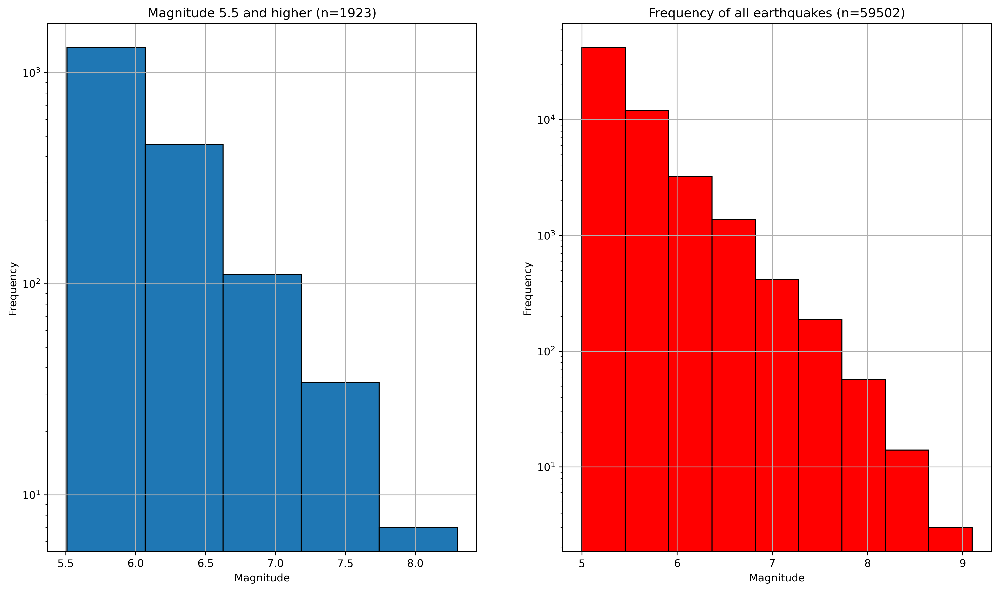

In [25]:
#create figure
plt.figure(figsize=(16,9), dpi=300)

#create subplots
plt.subplot(1,2,1) #1 row, 2 cols and first position
#histogram, with ylog scale, grid and edges of bins in black
EQ55['mag'].plot(kind='hist',logy=True, grid=True, edgecolor='black', bins=5)

plt.xlabel('Magnitude')
plt.title('Magnitude 5.5 and higher (n=%d)'%len(EQ55))

plt.subplot(1,2,2)
EQ_df['mag'].plot(kind='hist',logy=True, grid=True, color='red', edgecolor='black', bins=9)
plt.xlabel('Magnitude')
plt.title('Frequency of all earthquakes (n=%d)'%len(EQ_df))

In [26]:
#remove duplicates
EQ_df.drop_duplicates(inplace=True)

### Save to HDF and CSV files

In [27]:
EQ_df.to_hdf('Global_earthquakes_1980-2024_Mw5-9.hdf',key='USGS', complevel=9, complib='bzip2')

In [28]:
EQ_df[['longitude','latitude','mag','depth']].to_csv('Global_earthquakes_1980-2024_Mw5-9.csv.gz', index=True, sep=',', compression='gzip')

## Some time series analysis

Currently, our data are sorted by earthquake event:

In [29]:
EQ_df.head()

,time,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,...,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
id,,,,,,,,,,,,,,,,,,,,,
usp0006qpb,1994-12-31 20:52:27.750000+00:00,35.820,139.993,75.8,5.1,mw,NaN,NaN,NaN,0.9,...,2016-11-10 00:20:19.469000+00:00,"4 km SSE of Kashiwa, Japan",earthquake,NaN,3.8,NaN,NaN,reviewed,us,hrv
usp0006qp8,1994-12-31 20:10:26.030000+00:00,20.783,146.652,33.0,5.3,mb,NaN,NaN,NaN,0.9,...,2014-11-07 00:57:00.984000+00:00,Mariana Islands region,earthquake,NaN,NaN,NaN,12.0,reviewed,us,us
usp0006qp1,1994-12-31 17:17:26.810000+00:00,40.183,142.786,33.0,5.0,mb,NaN,NaN,NaN,1.0,...,2014-11-07 00:57:00.965000+00:00,"93 km NE of Miyako, Japan",earthquake,NaN,NaN,NaN,19.0,reviewed,us,us
usp0006qny,1994-12-31 13:50:23.700000+00:00,40.217,142.546,43.0,6.0,mw,NaN,NaN,NaN,1.0,...,2022-04-28 17:19:41.067000+00:00,"81 km NE of Miyako, Japan",earthquake,NaN,4.0,NaN,NaN,reviewed,us,hrv
usp0006qnv,1994-12-31 11:05:59.870000+00:00,2.475,126.188,86.8,5.2,mb,NaN,NaN,NaN,0.7,...,2014-11-07 00:57:00.923000+00:00,"173 km NE of Laikit, Laikit II (Dimembe), Indo...",earthquake,NaN,8.6,NaN,16.0,reviewed,us,us


In [31]:
EQ_df.dtypes

time               datetime64[ns, UTC]
latitude                       float64
longitude                      float64
depth                          float64
mag                            float64
magType                         object
nst                            float64
gap                            float64
dmin                           float64
rms                            float64
net                             object
updated            datetime64[ns, UTC]
place                           object
type                            object
horizontalError                float64
depthError                     float64
magError                       float64
magNst                         float64
status                          object
locationSource                  object
magSource                       object
dtype: object

Let's sorty by time

In [32]:
EQ_df.set_index('time', inplace=True)
EQ_df.sort_index(inplace=True)
EQ_df.head()

,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,net,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
time,,,,,,,,,,,,,,,,,,,,
1990-01-01 07:49:35.570000+00:00,-21.772,-179.361,599.5,5.4,mw,NaN,NaN,NaN,1.1,us,2016-11-09 21:34:42.445000+00:00,Fiji region,earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
1990-01-01 14:49:00.690000+00:00,-10.507,161.387,36.7,5.2,mw,NaN,NaN,NaN,0.9,us,2022-04-28 20:00:28.519000+00:00,"58 km W of Kirakira, Solomon Islands",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
1990-01-01 16:07:27.320000+00:00,-7.183,125.242,527.1,5.3,mw,NaN,NaN,NaN,1.1,us,2016-11-09 21:34:43.440000+00:00,"155 km N of Likisá, Timor Leste",earthquake,NaN,4.7,NaN,NaN,reviewed,us,hrv
1990-01-01 17:21:38.880000+00:00,-19.151,167.313,10.0,5.3,mw,NaN,NaN,NaN,1.1,us,2016-11-09 21:34:43.923000+00:00,"185 km NNE of Fayaoué, New Caledonia",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
1990-01-01 18:03:19.250000+00:00,6.830,-72.995,157.8,5.3,mb,NaN,NaN,NaN,1.1,us,2014-11-07 00:45:27.077000+00:00,"8 km NNW of Cepitá, Colombia",earthquake,NaN,5.8,NaN,24.0,reviewed,us,us


<Axes: xlabel='time'>

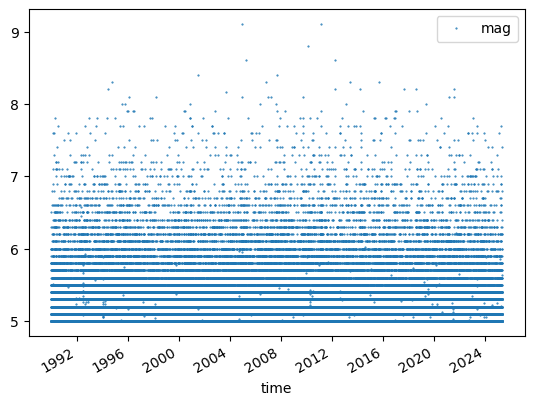

In [33]:
EQ_df.plot(y='mag', marker='.', markersize=1, linestyle='none', use_index=True)

In [34]:
EQ_df_mag_month = EQ_df['mag'].resample('ME').mean()
EQ_df_mag_month

time
1990-01-31 00:00:00+00:00    5.354545
1990-02-28 00:00:00+00:00    5.349685
1990-03-31 00:00:00+00:00    5.385517
1990-04-30 00:00:00+00:00    5.368984
1990-05-31 00:00:00+00:00    5.500000
                               ...   
2025-01-31 00:00:00+00:00    5.258553
2025-02-28 00:00:00+00:00    5.244574
2025-03-31 00:00:00+00:00    5.373684
2025-04-30 00:00:00+00:00    5.320688
2025-05-31 00:00:00+00:00    5.362600
Freq: ME, Name: mag, Length: 425, dtype: float64

<Axes: xlabel='time'>

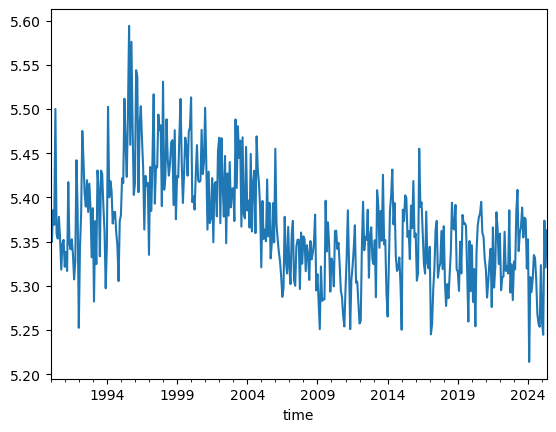

In [35]:
#plotting global average
#ax=EQ_df.plot(y='mag', marker='.', markersize=0.1, color='gray', linestyle='none', use_index=True)
EQ_df_mag_month.plot(y='mag', use_index=True)
#ax.set_ylim([5,6])

### Let's calculate mean earthquake magnitudes for the northern and southern hemisphere

In [36]:
EQ_nh_df = EQ_df[EQ_df['latitude'] >= 0]
print(len(EQ_nh_df))
EQ_nh_df

26431


,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,net,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
time,,,,,,,,,,,,,,,,,,,,
1990-01-01 18:03:19.250000+00:00,6.8300,-72.9950,157.800,5.3,mb,NaN,NaN,NaN,1.10,us,2014-11-07 00:45:27.077000+00:00,"8 km NNW of Cepitá, Colombia",earthquake,NaN,5.800,NaN,24.0,reviewed,us,us
1990-01-02 01:25:06.560000+00:00,8.3440,127.4410,40.900,5.6,mw,NaN,NaN,NaN,1.10,us,2022-04-28 20:00:30.802000+00:00,Philippine Islands region,earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
1990-01-02 20:21:32.620000+00:00,13.4080,144.4390,135.800,5.8,mw,NaN,NaN,NaN,1.00,us,2022-04-28 20:00:37.654000+00:00,"23 km W of Agat Village, Guam",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
1990-01-04 23:25:57.190000+00:00,32.3810,138.8210,247.700,5.2,mw,NaN,NaN,NaN,0.90,us,2016-11-09 21:35:52.211000+00:00,"252 km SSE of ?yama, Japan",earthquake,NaN,3.600,NaN,NaN,reviewed,us,hrv
1990-01-05 07:16:51.780000+00:00,41.8360,-126.7960,10.000,5.4,mw,NaN,NaN,NaN,1.00,us,2016-11-09 21:36:18.101000+00:00,"204 km WSW of Pistol River, Oregon",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-05 10:09:59.323000+00:00,23.9589,122.0347,10.000,5.3,mb,131.0,33.0,0.455,0.99,us,2025-05-05 18:40:42.083000+00:00,"43 km E of Hualien City, Taiwan",earthquake,3.65,1.823,0.037,248.0,reviewed,us,us
2025-05-05 10:53:25.412000+00:00,23.9146,122.0473,10.000,5.7,mww,131.0,34.0,0.488,1.07,us,2025-05-06 11:21:47.218000+00:00,"45 km E of Hualien City, Taiwan",earthquake,4.65,1.811,0.057,30.0,reviewed,us,us
2025-05-05 21:14:02.914000+00:00,64.6197,-17.4813,10.000,5.3,mww,85.0,42.0,1.658,0.34,us,2025-05-05 22:11:18.040000+00:00,"116 km WNW of Höfn, Iceland",earthquake,8.57,1.819,0.083,14.0,reviewed,us,us


In [37]:
EQ_sh_df = EQ_df[EQ_df['latitude'] < 0]
print(len(EQ_sh_df))

33071


In [38]:
# here we are doing 3-months averages
EQ_sh_df_mag_month = EQ_sh_df['mag'].resample('3ME').mean()
EQ_nh_df_mag_month = EQ_nh_df['mag'].resample('3ME').mean()

In [39]:
EQ_nh_df_mag_month

time
1990-01-31 00:00:00+00:00    5.382812
1990-04-30 00:00:00+00:00    5.360514
1990-07-31 00:00:00+00:00    5.404184
1990-10-31 00:00:00+00:00    5.340741
1991-01-31 00:00:00+00:00    5.341364
                               ...   
2024-07-31 00:00:00+00:00    5.335043
2024-10-31 00:00:00+00:00    5.326870
2025-01-31 00:00:00+00:00    5.312687
2025-04-30 00:00:00+00:00    5.352644
2025-07-31 00:00:00+00:00    5.394167
Freq: 3ME, Name: mag, Length: 143, dtype: float64

<Axes: xlabel='time'>

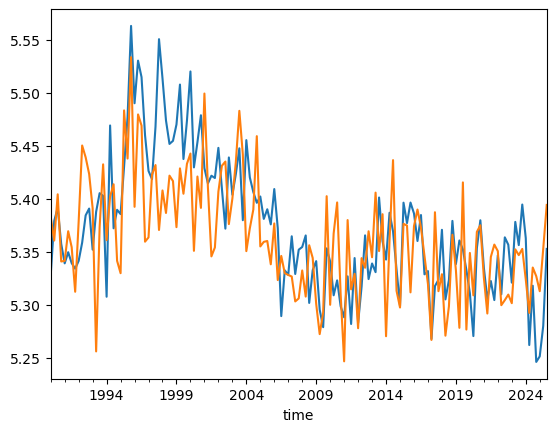

In [40]:
EQ_sh_df_mag_month.plot(y='mag', use_index=True)
EQ_nh_df_mag_month.plot(y='mag', use_index=True)

Text(0.5, 1.0, 'Earthquakes in the northern and southern hemispheres')

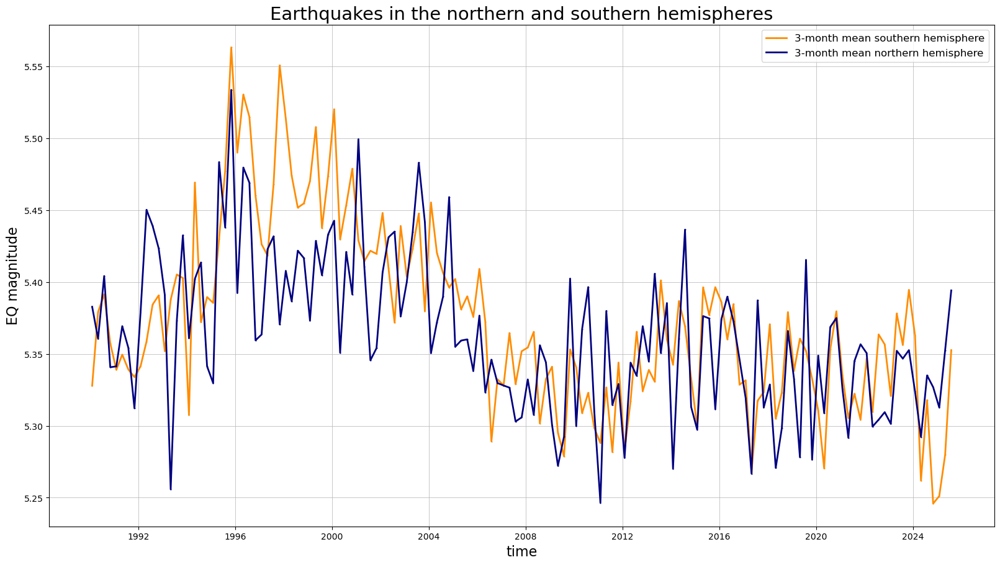

In [41]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 9),
                      constrained_layout=True)

ax.plot(EQ_sh_df_mag_month.index, EQ_sh_df_mag_month.values, 
        marker='.', color='darkorange', linewidth=2, 
        markersize=1, label='3-month mean southern hemisphere')

ax.plot(EQ_nh_df_mag_month.index, EQ_nh_df_mag_month.values, 
        marker='.', color='navy', linewidth=2, 
        markersize=1, label='3-month mean northern hemisphere')

ax.set_xlabel('time', fontsize=16)
ax.set_ylabel('mean EQ magnitude', fontsize=16)
ax.legend(fontsize=12)
ax.grid(lw=0.5)

ax.set_title('Earthquakes in the northern and southern hemispheres', fontsize=21)


<div class="alert alert-block alert-warning">
<b>Task 3.1</b>

What about uncertainties?

</div>

### Answer Task 3.1

In [43]:
EQ_sh_df_mag_month_q25 = EQ_sh_df['mag'].resample('3ME').quantile(0.25)
EQ_nh_df_mag_month_q25 = EQ_nh_df['mag'].resample('3ME').quantile(0.25)

EQ_sh_df_mag_month_q75 = EQ_sh_df['mag'].resample('3ME').quantile(0.75)
EQ_nh_df_mag_month_q75 = EQ_nh_df['mag'].resample('3ME').quantile(0.75)

We are using errorbar https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.errorbar.html


In [48]:
np.c_[EQ_sh_df_mag_month_q25, EQ_sh_df_mag_month_q75]

(143, 2)

In [55]:
EQ_sh_df_mag_month - EQ_sh_df_mag_month_q75

time
1990-01-31 00:00:00+00:00   -0.172059
1990-04-30 00:00:00+00:00   -0.220874
1990-07-31 00:00:00+00:00   -0.108571
1990-10-31 00:00:00+00:00   -0.142623
1991-01-31 00:00:00+00:00   -0.161029
                               ...   
2024-07-31 00:00:00+00:00   -0.132128
2024-10-31 00:00:00+00:00   -0.154091
2025-01-31 00:00:00+00:00   -0.148837
2025-04-30 00:00:00+00:00   -0.120087
2025-07-31 00:00:00+00:00   -0.047368
Freq: 3ME, Name: mag, Length: 143, dtype: float64

Text(0.5, 1.0, 'Earthquakes in the northern and southern hemispheres')

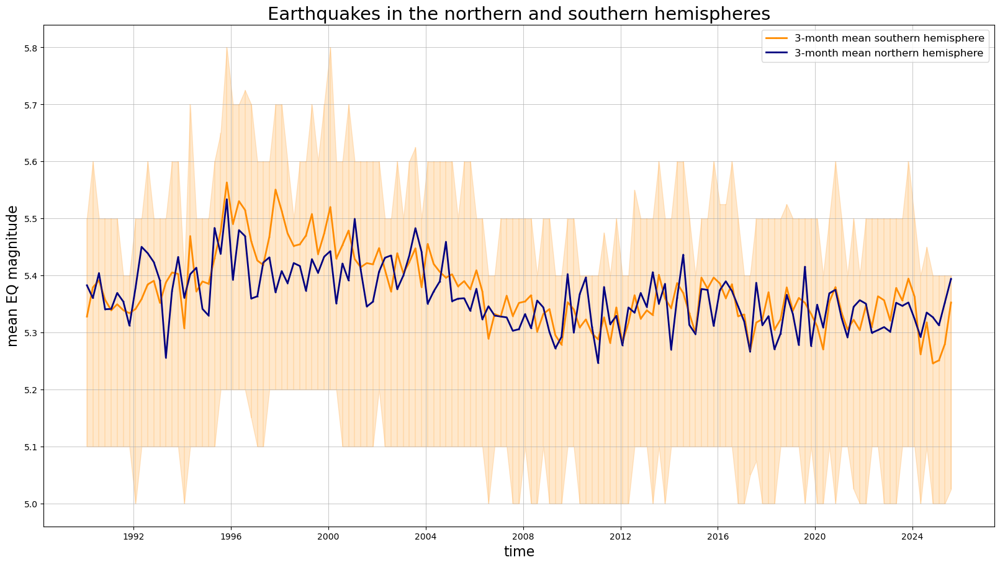

In [63]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 9),
                      constrained_layout=True)

ax.plot(EQ_sh_df_mag_month.index, EQ_sh_df_mag_month.values, 
        marker='.', color='darkorange', linewidth=2, 
        markersize=1, label='3-month mean southern hemisphere')

ax.errorbar(EQ_sh_df_mag_month.index, EQ_sh_df_mag_month.values, 
            yerr=np.c_[EQ_sh_df_mag_month - EQ_sh_df_mag_month_q25, EQ_sh_df_mag_month_q75- EQ_sh_df_mag_month].T,
           color='darkorange', linewidth=0.2)

#ax.fill_between(EQ_sh_df_mag_month.index, EQ_sh_df_mag_month_q25, EQ_sh_df_mag_month_q75, color='darkorange', alpha=0.2)

ax.plot(EQ_nh_df_mag_month.index, EQ_nh_df_mag_month.values, 
        marker='.', color='navy', linewidth=2, 
        markersize=1, label='3-month mean northern hemisphere')

ax.set_xlabel('time', fontsize=16)
ax.set_ylabel('mean EQ magnitude', fontsize=16)
ax.legend(fontsize=12)
ax.grid(lw=0.5)

ax.set_title('Earthquakes in the northern and southern hemispheres', fontsize=21)


### But where were the largest earthquakes each year?

In [64]:
max_EQ = EQ_df['mag'].resample('YE').max()
max_EQ.head()

time
1990-12-31 00:00:00+00:00    7.8
1991-12-31 00:00:00+00:00    7.6
1992-12-31 00:00:00+00:00    7.8
1993-12-31 00:00:00+00:00    7.8
1994-12-31 00:00:00+00:00    8.3
Freq: YE-DEC, Name: mag, dtype: float64

In [65]:
i=0
np.where((EQ_df['mag'] == max_EQ.iloc[i]) & (EQ_df.index.year == max_EQ.index.year[i]) )[0]

array([516])

In [66]:
max_index = np.zeros( len(max_EQ), dtype=int)
for i in range(len(max_EQ)):
    max_index[i] = np.where( (EQ_df['mag'] == max_EQ.iloc[i]) & (EQ_df.index.year == max_EQ.index.year[i]) )[0][0]
max_index

array([  516,  2288,  4892,  5964,  7768,  9158,  9923, 12066, 12629,
       14252, 15839, 16774, 18594, 19723, 21582, 22447, 25270, 27073,
       28545, 31253, 32220, 34712, 37496, 39397, 40634, 43070, 45122,
       46285, 47811, 49245, 51036, 52967, 55081, 55762, 57391, 59279])

In [67]:
EQ_max_df = EQ_df.iloc[max_index]
EQ_max_df

,latitude,longitude,depth,mag,magType,nst,gap,dmin,rms,net,updated,place,type,horizontalError,depthError,magError,magNst,status,locationSource,magSource
time,,,,,,,,,,,,,,,,,,,,
1990-04-18 13:39:19.010000+00:00,1.1860,122.8570,25.70,7.80,mw,NaN,NaN,NaN,1.20,us,2022-04-28 19:52:05.247000+00:00,"75 km NNW of Gorontalo, Indonesia",earthquake,NaN,NaN,NaN,NaN,reviewed,us,par
1991-04-22 21:56:51.820000+00:00,9.6850,-83.0730,10.00,7.60,mw,NaN,NaN,NaN,1.20,us,2022-04-28 19:18:34.851000+00:00,"34 km S of Limón, Costa Rica",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
1992-12-12 05:29:26.350000+00:00,-8.4800,121.8960,27.70,7.80,mw,NaN,NaN,NaN,1.40,us,2022-04-28 18:25:34.047000+00:00,"37 km WNW of Maumere, Indonesia",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
1993-08-08 08:34:24.930000+00:00,12.9820,144.8010,59.30,7.80,mw,NaN,NaN,NaN,1.10,us,2025-05-04 03:45:17.598000+00:00,"32 km S of Inarajan Village, Guam",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
1994-10-04 13:22:55.840000+00:00,43.7730,147.3210,14.00,8.30,mw,NaN,NaN,NaN,0.90,us,2022-04-28 17:22:14.274000+00:00,"48 km E of Shikotan, Russia",earthquake,NaN,4.700,NaN,NaN,reviewed,us,hrv
1995-07-30 05:11:23.630000+00:00,-23.3400,-70.2940,45.60,8.00,mw,NaN,NaN,NaN,1.10,us,2022-04-29 20:18:16.400000+00:00,"36 km NNE of Antofagasta, Chile",earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv
1996-02-17 05:59:30.550000+00:00,-0.8910,136.9520,33.00,8.09,mww,NaN,NaN,NaN,NaN,official,2022-04-29 20:09:13.696000+00:00,"101 km ENE of Biak, Indonesia",earthquake,NaN,NaN,NaN,NaN,reviewed,us,duputel
1997-10-14 09:53:18.150000+00:00,-22.1010,-176.7720,167.30,7.80,mwb,NaN,NaN,NaN,0.93,us,2022-04-29 17:04:56.379000+00:00,"192 km WSW of Haveluloto, Tonga",earthquake,NaN,NaN,NaN,NaN,reviewed,us,us
1998-03-25 03:12:25.070000+00:00,-62.8770,149.5270,10.00,8.10,mwc,NaN,NaN,NaN,1.10,us,2022-04-29 17:21:43.239000+00:00,Balleny Islands region,earthquake,NaN,NaN,NaN,NaN,reviewed,us,hrv


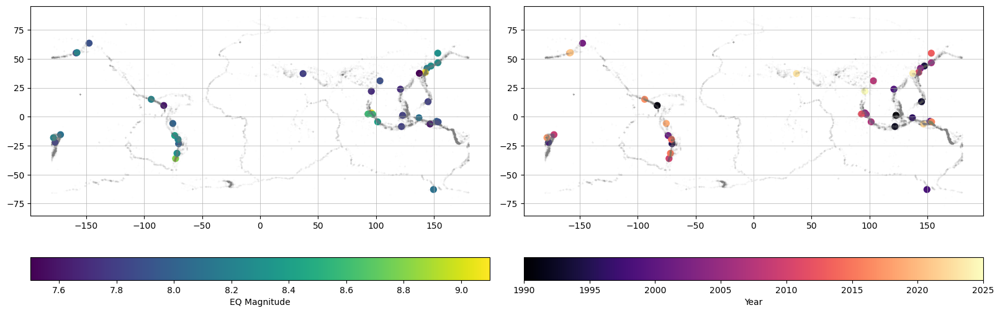

In [68]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(16, 9),
                      constrained_layout=True)

ax[0].plot(EQ_df['longitude'], EQ_df['latitude'], '.', ms=0.05, color='gray', alpha=0.5)
im0 = ax[0].scatter(EQ_max_df['longitude'], EQ_max_df['latitude'], c=EQ_max_df['mag'], s=50)
ax[0].grid(lw=0.5)
ax[0].set_aspect('equal')
h = plt.colorbar(im0, ax=ax[0], orientation='horizontal')
h.set_label('EQ Magnitude')

ax[1].plot(EQ_df['longitude'], EQ_df['latitude'], '.', ms=0.05, color='gray', alpha=0.5)
im1 = ax[1].scatter(EQ_max_df['longitude'], EQ_max_df['latitude'], 
                    c=EQ_max_df.index.year, s=50, cmap='magma')
ax[1].grid(lw=0.5)
ax[1].set_aspect('equal')
h = plt.colorbar(im1, ax=ax[1], orientation='horizontal')
h.set_label('Year')

## Map plotting with cartopy

[Cartopy](https://scitools.org.uk/cartopy/docs/latest/) is a quick way to visualize spatial data. It support different projections and allows to combine grid and vector data. With some tweaks, the plots can look appealing. But if you are looking for a way to make publication-ready plot, you will need to look at [GMT](https://www.generic-mapping-tools.org/) (for example the python implementation: https://www.pygmt.org/latest/). The learning curve of this is very steep and we will introduce this at some other time for an interested audience.

Make sure that you have installed cartopy.


In [20]:
!conda install -y -c conda-forge cartopy

Channels:
 - conda-forge
 - defaults
Platform: linux-64
Solving environment: done

## Package Plan ##

  environment location: /home/bodo/miniconda3/envs/Py3_geodata

  added / updated specs:
    - cartopy


The following NEW packages will be INSTALLED:

  cartopy            conda-forge/linux-64::cartopy-0.24.0-py312hf9745cd_0 
  pyshp              conda-forge/noarch::pyshp-2.3.1-pyhd8ed1ab_1 
  shapely            conda-forge/linux-64::shapely-2.1.0-py312h21f5128_0 




Preparing transaction: done
Verifying transaction: done
Executing transaction: done


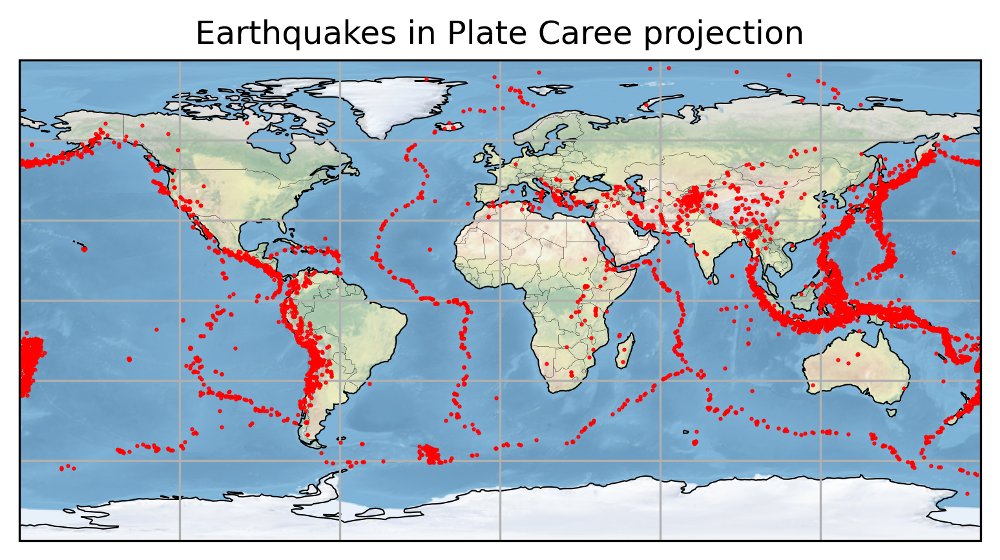

In [69]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Set up a custom projection
projection = ccrs.PlateCarree()

# Set up a figure
fig = plt.figure(dpi=300)
ax = fig.add_subplot(111, projection=projection)

# Draw standard features
ax.gridlines()
ax.coastlines(linewidth=0.5)
ax.stock_img() # see here for using your own background images: http://earthpy.org/cartopy_backgroung.html
ax.add_feature(cfeature.BORDERS, linewidth=0.1)

ax.set_title("Earthquakes in Plate Caree projection")

# we could plot all EQ (in EQ_df), but this will be slow.
ax.plot(EQ5['longitude'], EQ5['latitude'], 'r.', ms=1)
#ac.scatter(EQ5['longitude'], EQ5['latitude'], c=EQ5['mag'], s=5)

### Map plot in Mollweide projection

Additional projections can be found here: https://scitools.org.uk/cartopy/docs/v0.15/crs/projections.html

In [70]:
np.max(EQ5['mag'])

np.float64(8.3)

Text(0.5, 1.0, 'Mollweide')

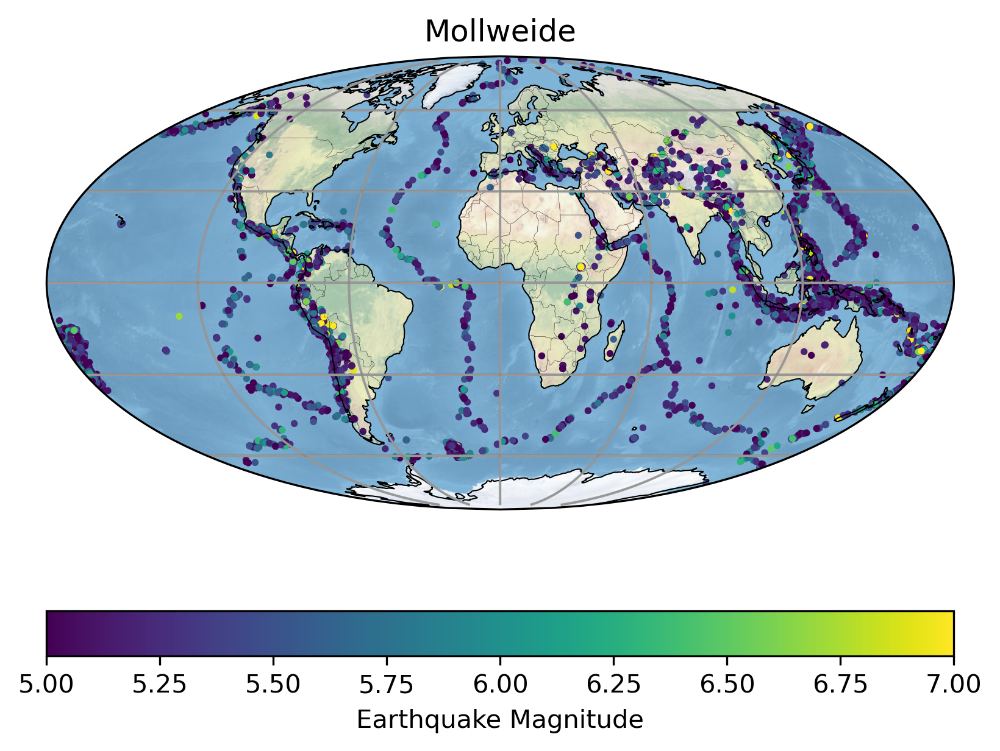

In [71]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Set up a custom projection
projection = ccrs.Mollweide()

# Set up a figure
fig = plt.figure(dpi=300)
ax = fig.add_subplot(111, projection=projection)

# Draw standard features
ax.gridlines()
ax.coastlines(linewidth=0.5)
ax.stock_img()
ax.add_feature(cfeature.BORDERS, linewidth=0.1)
gl = ax.gridlines(
    draw_labels=False, linewidth=1, color='gray', alpha=0.5, linestyle='-'
)

eq = ax.scatter(EQ5['longitude'], 
           EQ5['latitude'], 
           c=EQ5['mag'], 
           s=3, transform=ccrs.PlateCarree(), 
                vmin=5, vmax=7)

h=plt.colorbar(eq, orientation='horizontal', ax=ax)
h.set_label('Earthquake Magnitude')

ax.set_title("Mollweide")

### Max. Earthquakes in Mollweide projection

In [72]:
EQ_max_df['longitude'].iloc[i]

np.float64(95.9247)

Text(0.5, 1.0, 'Mollweide')

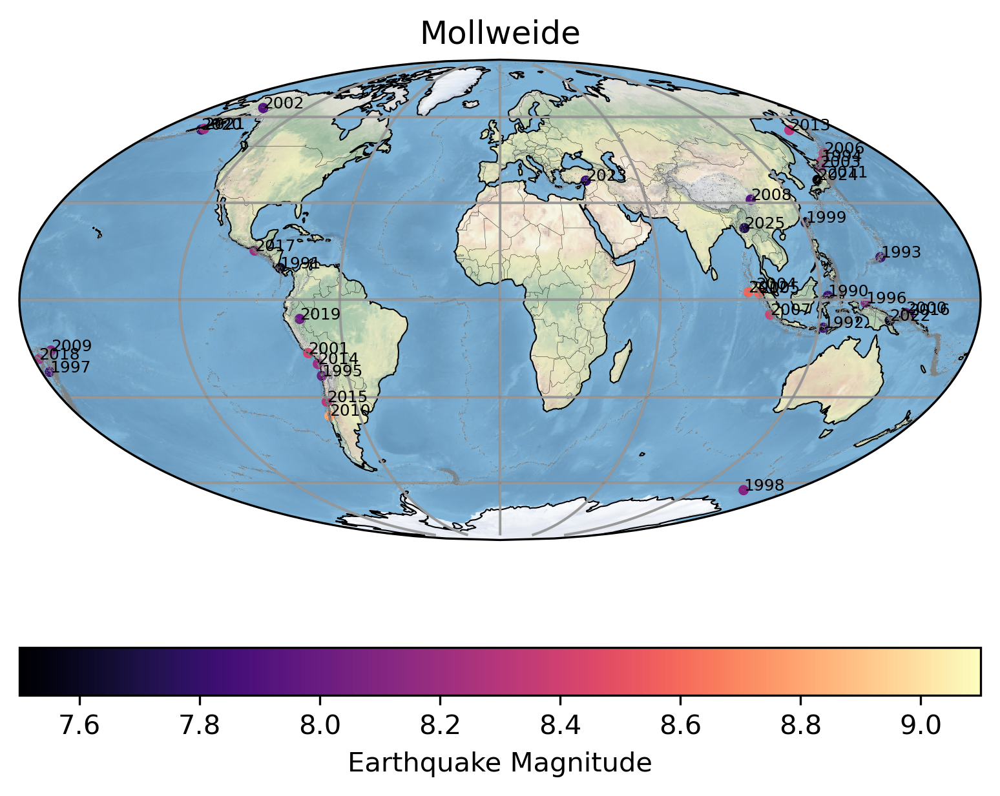

In [73]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Set up a custom projection
projection = ccrs.Mollweide()

# Set up a figure
fig = plt.figure(dpi=300)
ax = fig.add_subplot(111, projection=projection)

# Draw standard features
ax.gridlines()
ax.coastlines(linewidth=0.5)
ax.stock_img()
ax.add_feature(cfeature.BORDERS, linewidth=0.1)
gl = ax.gridlines(
    draw_labels=False, linewidth=1, color='gray', alpha=0.5, linestyle='-'
)

eq = ax.scatter(EQ_max_df['longitude'], 
           EQ_max_df['latitude'], 
           c=EQ_max_df['mag'], cmap='magma',
           s=8, transform=ccrs.PlateCarree())
h=plt.colorbar(eq, orientation='horizontal', ax=ax)
h.set_label('Earthquake Magnitude')

#Add Year as text for each EQ - plot each year and label separately
for i in range(len(EQ_max_df)):
    ax.text(EQ_max_df['longitude'].iloc[i], 
               EQ_max_df['latitude'].iloc[i], 
               str(EQ_max_df.index.year.to_numpy()[i]), 
            transform=ccrs.PlateCarree(), fontsize=6 )

ax.plot(EQ_df['longitude'], EQ_df['latitude'], ',', ms=0.1, c='gray', transform=ccrs.PlateCarree(), alpha=0.5)

ax.set_title("Mollweide")

### Map plot in Lambert Azimuthal Equal Area for the Central Andes

Let's use earthquake depth as another attribute

In [74]:
EQ5['depth']

id
usp0006qpb     75.8
usp0006qp8     33.0
usp0006qp1     33.0
usp0006qny     43.0
usp0006qnv     86.8
              ...  
usp00043tv    157.8
usp00043tu     10.0
usp00043tq    527.1
usp00043tp     36.7
usp00043tf    599.5
Name: depth, Length: 8281, dtype: float64

/home/bodo/miniconda3/envs/Py3_geodata/lib/python3.12/site-packages/matplotlib/collections.py:1008: RuntimeWarning: invalid value encountered in sqrt
  scale = np.sqrt(self._sizes) * dpi / 72.0 * self._factor


Text(0.5, 1.0, 'Lambert Azimuthal Equal Area')

/home/bodo/miniconda3/envs/Py3_geodata/lib/python3.12/site-packages/matplotlib/collections.py:1008: RuntimeWarning: invalid value encountered in sqrt
  scale = np.sqrt(self._sizes) * dpi / 72.0 * self._factor
/home/bodo/miniconda3/envs/Py3_geodata/lib/python3.12/site-packages/matplotlib/collections.py:1008: RuntimeWarning: invalid value encountered in sqrt
  scale = np.sqrt(self._sizes) * dpi / 72.0 * self._factor
/home/bodo/miniconda3/envs/Py3_geodata/lib/python3.12/site-packages/matplotlib/collections.py:1008: RuntimeWarning: invalid value encountered in sqrt
  scale = np.sqrt(self._sizes) * dpi / 72.0 * self._factor


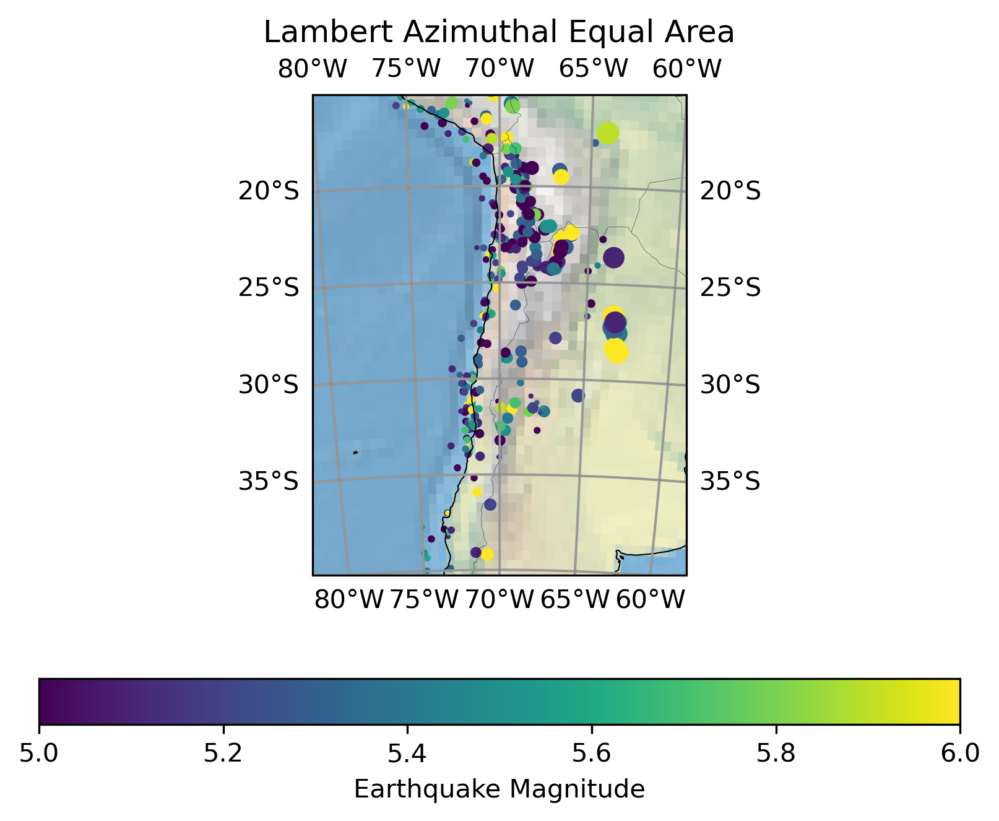

In [75]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Set up a custom projection
projection = ccrs.LambertAzimuthalEqualArea(
    central_longitude=-70,
    central_latitude=-20,
)

# Set up a figure
fig = plt.figure(dpi=300)
ax = fig.add_subplot(111, projection=projection)
ax.set_extent((-80., -60, -15., -40.))

# Draw standard features
ax.gridlines()
ax.coastlines(linewidth=0.5)
ax.stock_img()
ax.add_feature(cfeature.BORDERS, linewidth=0.1)
gl = ax.gridlines(
    draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='-'
)

eq = ax.scatter(EQ5['longitude'], 
           EQ5['latitude'], 
           c=EQ5['mag'], 
           s=EQ5['depth']/10, transform=ccrs.PlateCarree(),
               vmin=5, vmax=6)

h=plt.colorbar(eq, orientation='horizontal', ax=ax)
h.set_label('Earthquake Magnitude')

ax.set_title("Lambert Azimuthal Equal Area")

# Get Global EQ Data via the COMCAT service

[https://earthquake.usgs.gov/data/comcat/](https://earthquake.usgs.gov/data/comcat/)

The ANSS Comprehensive Earthquake Catalog (ComCat) contains earthquake source parameters (e.g. hypocenters, magnitudes, phase picks and amplitudes) and other products (e.g. moment tensor solutions, macroseismic information, tectonic summaries, maps) produced by contributing seismic networks.

First,  downloads the earthquake events within the specific locations bounds and with the magnitude filters.
Then it gets the focal mechanism for each one, which could be used to work out fault orientation.
This requires the installation of the libcomcat library to access the services. You can do so within jupyter lab:

```bash
!conda install -y -c conda-forge libcomcat obspy
````

# Visualize data with plotly

## Using the volcanic explosivity index (VEI)

We are using the volcanic explosivity index (VEI) (see [wikipedia](https://en.wikipedia.org/wiki/Volcanic_explosivity_index)).

Additional volcano databases can be found here: https://www.ncei.noaa.gov/access/metadata/landing-page/bin/iso?id=gov.noaa.ngdc.mgg.hazards:G10147

If not already installed, you may need to install plotly

In [3]:
!conda install -y -c conda-forge plotly jupyterlab anywidget

Channels:
 - conda-forge
 - defaults
Platform: linux-64
Solving environment: done

# All requested packages already installed.



In [76]:
import plotly.express as px
import pandas as pd

In [77]:
volcano = pd.read_csv('../EQ_data/volcano.csv')
volcano.head()

,VolcanoID,V_Name,Country,Region,Subregion,Latitude,Longitude,PEI,H_active,VEI_Holoce,hazard,class,risk
0,210010,West Eifel Volcanic Field,Germany,Mediterranean and W Asia,Western Europe,50.170,6.85,6,0,Unknown VEI,NaN,U-HR,NaN
1,210020,Cha?ne des Puys,France,Mediterranean and W Asia,Western Europe,45.775,2.97,7,0,Unknown VEI,NaN,U-HR,NaN
2,210030,Olot Volcanic Field,Spain,Mediterranean and W Asia,Western Europe,42.170,2.53,5,0,No confirmed eruptions,NaN,U-NHHR,NaN
3,210040,Calatrava Volcanic Field,Spain,Mediterranean and W Asia,Western Europe,38.870,-4.02,6,0,Unknown VEI,NaN,U-HR,NaN
4,211001,Larderello,Italy,Mediterranean and W Asia,Italy,43.250,10.87,4,0,3,NaN,U-HR,NaN


In [78]:
fig = px.scatter_geo(volcano, lat="Latitude", lon='Longitude', color="VEI_Holoce",
                     projection="orthographic")
fig.update_layout(
        title = 'Volcanic Eruptions during the Holocene',
        geo_scope='world')
fig.show()

## Significant volcanic eruption database

https://www.ncei.noaa.gov/access/metadata/landing-page/bin/iso?id=gov.noaa.ngdc.mgg.hazards:G10147

In [5]:
volcanic_eruptions = pd.read_csv('EQ_data/significant-volcanic-eruption-database.csv', sep=';')
volcanic_eruptions.head()

,Year,Month,Day,Flag Tsunami,Flag Earthquake,Volcano Name,Location,Country,Elevation,Volcano Type,...,Total Effects : Missing Description,Total Effects : Injuries,Total Effects : Injuries Description,Total Effects : Damages in million Dollars,Total Effects : Damage Description,Total Effects : Houses Destroyed,Total Effects : Houses Destroyed Description,Coordinates,Earthquakes : Houses damaged Description,Total Effects : Houses Damaged Description
0,1280,NaN,NaN,NaN,NaN,Quilotoa,Ecuador,Ecuador,3914,Caldera,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"-0.85,-78.9",NaN,NaN
1,1540,NaN,NaN,Tsunami,NaN,Augustine,Alaska-SW,United States,1252,Lava dome,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"59.37,-153.42",NaN,NaN
2,1660,NaN,NaN,Tsunami,NaN,Long Island,New Guinea-NE of,Papua New Guinea,1280,Complex volcano,...,NaN,NaN,NaN,NaN,SEVERE (~>$5 to $24 million),NaN,Many (~101 to 1000 houses),"-5.358,147.12",NaN,NaN
3,1858,4.0,23.0,NaN,Earthquake,Tate-yama,Honshu-Japan,Japan,2621,Stratovolcano,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"36.57,137.6",NaN,NaN
4,1864,1.0,3.0,NaN,NaN,Kelut,Java,Indonesia,1731,Stratovolcano,...,NaN,NaN,NaN,NaN,NaN,NaN,Many (~101 to 1000 houses),"-7.93,112.308",NaN,NaN


In [12]:
volcanic_eruptions['Total Effects : Damage Description']

0                                                    NaN
1                                                    NaN
2                           SEVERE (~>$5 to $24 million)
3                                                    NaN
4                                                    NaN
                             ...                        
830                                                  NaN
831                         SEVERE (~>$5 to $24 million)
832    LIMITED (roughly corresponding to less than $1...
833    LIMITED (roughly corresponding to less than $1...
834                         MODERATE (~$1 to $5 million)
Name: Total Effects : Damage Description, Length: 835, dtype: object

In [6]:
#The field Coordinates contains both coordinates - latitude and longitude
volcanic_eruptions['Coordinates']

0          -0.85,-78.9
1        59.37,-153.42
2        -5.358,147.12
3          36.57,137.6
4        -7.93,112.308
            ...       
830        2.78,125.48
831    19.425,-155.292
832        3.17,98.392
833       -4.1,145.061
834        3.17,98.392
Name: Coordinates, Length: 835, dtype: object

In [7]:
latlong = volcanic_eruptions['Coordinates'].str.split(',')
latlong

0          [-0.85, -78.9]
1        [59.37, -153.42]
2        [-5.358, 147.12]
3          [36.57, 137.6]
4        [-7.93, 112.308]
              ...        
830        [2.78, 125.48]
831    [19.425, -155.292]
832        [3.17, 98.392]
833       [-4.1, 145.061]
834        [3.17, 98.392]
Name: Coordinates, Length: 835, dtype: object

In [8]:
geom = pd.DataFrame(latlong.tolist(), columns=['lat', 'long'], index=volcanic_eruptions.index).apply(pd.to_numeric, errors='coerce')
geom

,lat,long
0,-0.850,-78.900
1,59.370,-153.420
2,-5.358,147.120
3,36.570,137.600
4,-7.930,112.308
...,...,...
830,2.780,125.480
831,19.425,-155.292
832,3.170,98.392
833,-4.100,145.061


In [9]:
volcanic_eruptions = volcanic_eruptions.join(geom)
volcanic_eruptions.head()

,Year,Month,Day,Flag Tsunami,Flag Earthquake,Volcano Name,Location,Country,Elevation,Volcano Type,...,Total Effects : Injuries Description,Total Effects : Damages in million Dollars,Total Effects : Damage Description,Total Effects : Houses Destroyed,Total Effects : Houses Destroyed Description,Coordinates,Earthquakes : Houses damaged Description,Total Effects : Houses Damaged Description,lat,long
0,1280,NaN,NaN,NaN,NaN,Quilotoa,Ecuador,Ecuador,3914,Caldera,...,NaN,NaN,NaN,NaN,NaN,"-0.85,-78.9",NaN,NaN,-0.850,-78.900
1,1540,NaN,NaN,Tsunami,NaN,Augustine,Alaska-SW,United States,1252,Lava dome,...,NaN,NaN,NaN,NaN,NaN,"59.37,-153.42",NaN,NaN,59.370,-153.420
2,1660,NaN,NaN,Tsunami,NaN,Long Island,New Guinea-NE of,Papua New Guinea,1280,Complex volcano,...,NaN,NaN,SEVERE (~>$5 to $24 million),NaN,Many (~101 to 1000 houses),"-5.358,147.12",NaN,NaN,-5.358,147.120
3,1858,4.0,23.0,NaN,Earthquake,Tate-yama,Honshu-Japan,Japan,2621,Stratovolcano,...,NaN,NaN,NaN,NaN,NaN,"36.57,137.6",NaN,NaN,36.570,137.600
4,1864,1.0,3.0,NaN,NaN,Kelut,Java,Indonesia,1731,Stratovolcano,...,NaN,NaN,NaN,NaN,Many (~101 to 1000 houses),"-7.93,112.308",NaN,NaN,-7.930,112.308


In [10]:
volcanic_eruptions.drop(columns='Coordinates', inplace=True)

In [17]:
fig = px.scatter_geo(volcanic_eruptions, lat="lat", lon='long', color="Volcano Type",
                     projection="orthographic")
fig.update_layout(
        title = 'Significant Volcanoe eruptions',
        geo_scope='world')
fig.show()